<a href="https://colab.research.google.com/github/decile-team/submodlib/blob/master/tutorials/Image_Collection_Summarization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dataset

The image collection used for this application is a subset of [Imagenette dataset](https://github.com/fastai/imagenette). Specifically, it contains 40 images from each of the following categories: cassette player, church, garbage truck, gas pump, golf ball, parachute, dog

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


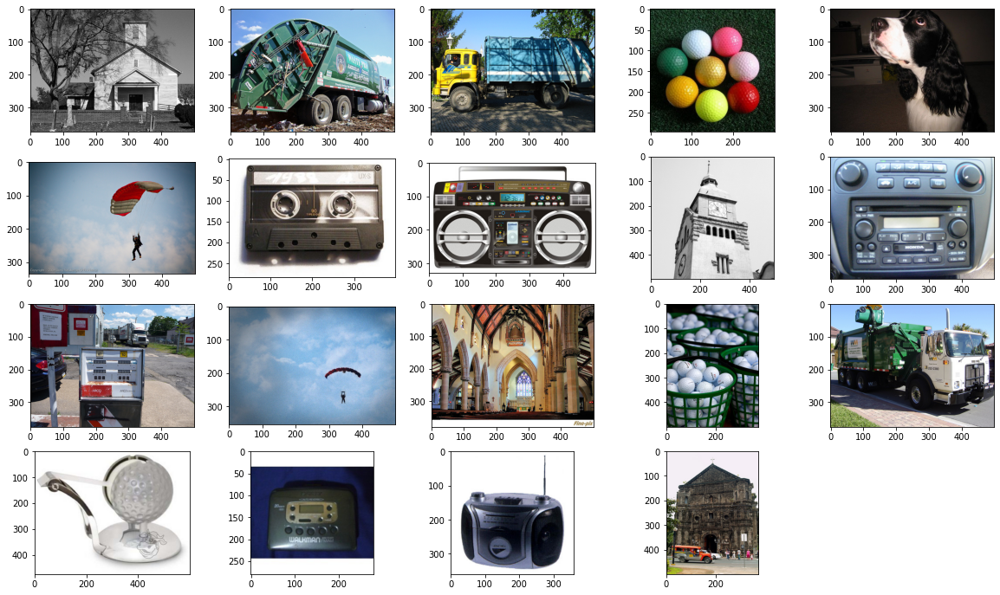

In [23]:
import os
import random
import matplotlib.pyplot as plt
import cv2

path = '/content/drive/MyDrive/demo-image-collection'
images = os.listdir(path)
random.seed(2)
some_images = random.sample(images, 20)
row = 0
index = 1
plt.figure(figsize=(20,12))
for image in some_images:
  image_path = os.path.join(path, image)
  if image_path.endswith("hdf5") or os.path.isdir(image_path):
    continue
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.subplot(4, 5, row*5+index)
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

# Feature Extraction

In [24]:
# Adapted from https://github.com/christiansafka/img2vec
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np

class Img2Vec():
    RESNET_OUTPUT_SIZES = {
        'resnet18': 512,
        'resnet34': 512,
        'resnet50': 2048,
        'resnet101': 2048,
        'resnet152': 2048,
    }

    def __init__(self, cuda=False, model='resnet-18', layer='default', layer_output_size=512):
        """ Img2Vec
        :param cuda: If set to True, will run forward pass on GPU
        :param model: String name of requested model
        :param layer: String or Int depending on model.
        :param layer_output_size: Int depicting the output size of the requested layer
        """
        print("Using: ", model, " for feature extraction.")
        self.device = torch.device("cuda" if cuda else "cpu")

        self.model_name = model
        self.layer_output_size = layer_output_size

        self.model, self.extraction_layer = self._get_model_and_layer(
            model, layer)

        self.model = self.model.to(self.device)

        self.model.eval()

        self.scaler = transforms.Resize((224, 224))
        self.normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                              std=[0.229, 0.224, 0.225])
        self.to_tensor = transforms.ToTensor()

    def get_vec(self, img):
        """ Get vector embedding from PIL image
        :param img: PIL Image
        :param tensor: If True, get_vec will return a FloatTensor instead of Numpy array
        :returns: Numpy ndarray
        """
        if type(img) == list:
            a = [self.normalize(self.to_tensor(self.scaler(im))) for im in img]
            images = torch.stack(a).to(self.device)
            if self.model_name in ['alexnet', 'vgg']:
                my_embedding = torch.zeros(len(img), self.layer_output_size)
            elif self.model_name == 'densenet':
                my_embedding = torch.zeros(len(img), self.layer_output_size, 7, 7)
            else:
                my_embedding = torch.zeros(len(img), self.layer_output_size, 1, 1)

            def copy_data(m, i, o):
                my_embedding.copy_(o.data)

            h = self.extraction_layer.register_forward_hook(copy_data)
            with torch.no_grad():
                h_x = self.model(images)
            h.remove()

            if self.model_name in ['alexnet', 'vgg']:
                return my_embedding.numpy()[:, :]
            elif self.model_name == 'densenet':
                return torch.mean(my_embedding, (2, 3), True).numpy()[:, :, 0, 0]
            else:
                return my_embedding.numpy()[:, :, 0, 0]
        else:
          image = self.normalize(self.to_tensor(
              self.scaler(img))).unsqueeze(0).to(self.device)

          if self.model_name in ['alexnet', 'vgg']:
              my_embedding = torch.zeros(1, self.layer_output_size)
          elif self.model_name == 'densenet':
              my_embedding = torch.zeros(1, self.layer_output_size, 7, 7)
          else:
              my_embedding = torch.zeros(1, self.layer_output_size, 1, 1)

          def copy_data(m, i, o):
              my_embedding.copy_(o.data)

          h = self.extraction_layer.register_forward_hook(copy_data)
          with torch.no_grad():
              h_x = self.model(image)
          h.remove()

          if self.model_name in ['alexnet', 'vgg']:
              return my_embedding.numpy()[0, :]
          elif self.model_name == 'densenet':
              return torch.mean(my_embedding, (2, 3), True).numpy()[0, :, 0, 0]
          else:
              return my_embedding.numpy()[0, :, 0, 0]

    def _get_model_and_layer(self, model_name, layer):
        """ Internal method for getting layer from model
        :param model_name: model name such as 'resnet-18'
        :param layer: layer as a string for resnet-18 or int for alexnet
        :returns: pytorch model, selected layer
        """
        if model_name.startswith('resnet') and not model_name.startswith('resnet-'):
            model = getattr(models, model_name)(pretrained=True)
            if layer == 'default':
                layer = model._modules.get('avgpool')
                self.layer_output_size = self.RESNET_OUTPUT_SIZES[model_name]
            else:
                layer = model._modules.get(layer)
            return model, layer
        elif model_name == 'resnet-18':
            model = models.resnet18(pretrained=True)
            if layer == 'default':
                layer = model._modules.get('avgpool')
                self.layer_output_size = 512
            else:
                layer = model._modules.get(layer)

            return model, layer

        elif model_name == 'alexnet':
            model = models.alexnet(pretrained=True)
            if layer == 'default':
                layer = model.classifier[-2]
                self.layer_output_size = 4096
            else:
                layer = model.classifier[-layer]

            return model, layer

        elif model_name == 'vgg':
            # VGG-11
            model = models.vgg11_bn(pretrained=True)
            if layer == 'default':
                layer = model.classifier[-2]
                self.layer_output_size = model.classifier[-1].in_features # should be 4096
            else:
                layer = model.classifier[-layer]

            return model, layer

        elif model_name == 'densenet':
            # Densenet-121
            model = models.densenet121(pretrained=True)
            if layer == 'default':
                layer = model.features[-1]
                self.layer_output_size = model.classifier.in_features # should be 1024
            else:
                raise KeyError('Un support %s for layer parameters' % model_name)

            return model, layer
        elif model_name == 'googlenet':
            model = models.googlenet(pretrained=True)
            if layer == 'default':
                layer = model._modules.get('avgpool')
                self.layer_output_size = 1024
            else:
                layer = model._modules.get(layer)

            return model, layer
        else:
            raise KeyError('Model %s was not found' % model_name)

In [9]:
from PIL import Image
import h5py
import os

def extractFeatures(path, method):
  hdf5_path = os.path.join(path, 'features_'+method+'.hdf5')
  f = h5py.File(hdf5_path, mode='w')
  if method.startswith('resnet') or method == 'alexnet' or method == 'vgg' or method == 'densenet':
    img2vec = Img2Vec(cuda=False, model=method)
    images = os.listdir(path)
    imgs = []
    # features = []
    image_list = []
    index = 1
    for image in images:
      if image.endswith('hdf5') or os.path.isdir(os.path.join(path, image)):
        continue
      # print(image, index)
      image_path = os.path.join(path, image)
      img = Image.open(image_path).convert('RGB')
      # print(img.shape)
      imgs.append(img)
      # vector = img2vec.get_vec(img)
      # features.append(vector)
      image_list.append(image)
      index += 1
    vectors = img2vec.get_vec(imgs)
    # vectors = np.asarray(features, dtype=np.float32)
    print("Features from ", method, vectors.shape)
    f.create_dataset("features", data=vectors)
    f.create_dataset("images", data=image_list)
    f.close()

In [10]:
path = '/content/drive/MyDrive/demo-image-collection'
for model in ["resnet-18", "resnet50", "densenet", "alexnet", "vgg"]:
  extractFeatures(path, model)

Using:  resnet-18  for feature extraction.


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Features from  resnet-18 (280, 512)
Using:  resnet50  for feature extraction.
Features from  resnet50 (280, 2048)
Using:  densenet  for feature extraction.
Features from  densenet (280, 1024)
Using:  alexnet  for feature extraction.


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth



Features from  alexnet (280, 4096)
Using:  vgg  for feature extraction.


Downloading: "https://download.pytorch.org/models/vgg11_bn-6002323d.pth" to /root/.cache/torch/hub/checkpoints/vgg11_bn-6002323d.pth



Features from  vgg (280, 4096)


In [12]:
import h5py
import os
import cv2
import numpy as np

def extractHistFeatures(path, mode):
  hdf5_path = os.path.join(path, 'features_'+mode+'_hist.hdf5')
  f = h5py.File(hdf5_path, mode='w')
  images = os.listdir(path)
  imgs = []
  features = []
  image_list = []
  index = 1
  for image in images:
    if image.endswith('hdf5') or os.path.isdir(os.path.join(path, image)):
      continue
    # print(image, index)
    image_path = os.path.join(path, image)
    img = cv2.imread(image_path)
    if mode == "grey":
      gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
      histogram = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    elif mode == "color":
      hsv_image = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
      histogram = cv2.calcHist([hsv_image],[0, 1],None,[20, 16],[0, 180, 0, 256])
    else:
      raise Exception("Invalid mode")
    histogram = histogram.flatten()
    features.append(histogram)
    image_list.append(image)
    index += 1
  vectors = np.asarray(features, dtype=np.float32)
  print(mode, "histogram features: ", vectors.shape)
  f.create_dataset("features", data=vectors)
  f.create_dataset("images", data=image_list)
  f.close()

In [13]:
path = '/content/drive/MyDrive/demo-image-collection'
for mode in ["grey", "color"]:
  extractHistFeatures(path, mode)

grey histogram features:  (280, 256)
color histogram features:  (280, 320)


# Compute Kernels

In [45]:
!pip install -i https://test.pypi.org/simple/ --extra-index-url https://pypi.org/simple/ submodlib

Looking in indexes: https://test.pypi.org/simple/, https://pypi.org/simple/


In [20]:
from submodlib.helper import create_kernel
for model in ["color_hist", "alexnet", "densenet", "grey_hist", "resnet-18", "resnet50", "vgg"]:
  features_file = "features_"+model+".hdf5"
  hf = h5py.File(os.path.join(path, features_file), 'r')
  data = hf["features"][:]
  for metric in ["euclidean", "cosine"]:
    print("Computing kernel for ", model, " features using ", metric)
    K_dense = create_kernel(data, metric)
    with h5py.File(os.path.join(path, "kernel_"+metric+"_"+model+".hdf5"), 'w') as kf:
        kf.create_dataset("kernel",  data=K_dense)
    print("Done. Shape of kernel = ", K_dense.shape)
  hf.close()

Computing kernel for  color_hist  features using  euclidean
Done. Shape of kernel =  (280, 280)
Computing kernel for  color_hist  features using  cosine
Done. Shape of kernel =  (280, 280)
Computing kernel for  alexnet  features using  euclidean
Done. Shape of kernel =  (280, 280)
Computing kernel for  alexnet  features using  cosine
Done. Shape of kernel =  (280, 280)
Computing kernel for  densenet  features using  euclidean
Done. Shape of kernel =  (280, 280)
Computing kernel for  densenet  features using  cosine
Done. Shape of kernel =  (280, 280)
Computing kernel for  grey_hist  features using  euclidean
Done. Shape of kernel =  (280, 280)
Computing kernel for  grey_hist  features using  cosine
Done. Shape of kernel =  (280, 280)
Computing kernel for  resnet-18  features using  euclidean
Done. Shape of kernel =  (280, 280)
Computing kernel for  resnet-18  features using  cosine
Done. Shape of kernel =  (280, 280)
Computing kernel for  resnet50  features using  euclidean
Done. Shape

# How good are the features in capturing similarity? (Query in the dataset)

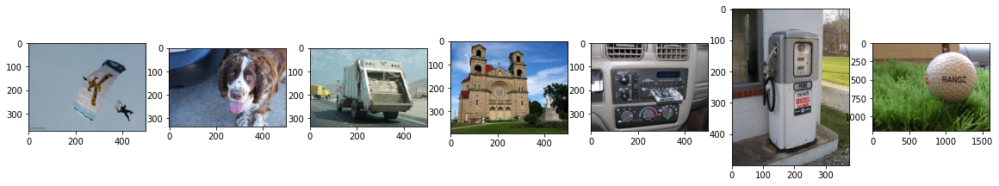

In [17]:
path = '/content/drive/MyDrive/demo-image-collection'
query1 = "ILSVRC2012_val_00002665.JPEG"  #parachute
query2 = "ILSVRC2012_val_00000665.JPEG"  #dog
query3 = "ILSVRC2012_val_00001144.JPEG"  #garbage truck
query4 = "ILSVRC2012_val_00015155.JPEG"  #church
query5 = "ILSVRC2012_val_00003944.JPEG"  #cassette player
query6 = "ILSVRC2012_val_00017469.JPEG"  #gas pump
query7 = "ILSVRC2012_val_00023215.JPEG"  #golf ball
queries = [query1, query2, query3, query4, query5, query6, query7]
index=1
plt.figure(figsize=(20,8))
for query in queries:
  image_path = os.path.join(path, query)
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.subplot(1, 7, index)
  plt.imshow(img)
  index+=1

#### color_hist euclidean ####



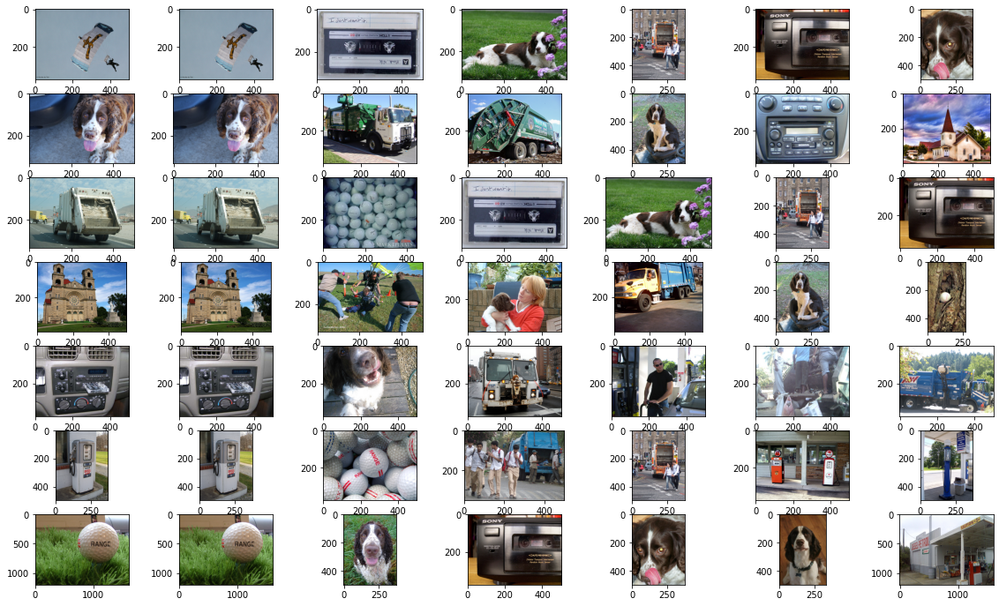

#### color_hist cosine ####



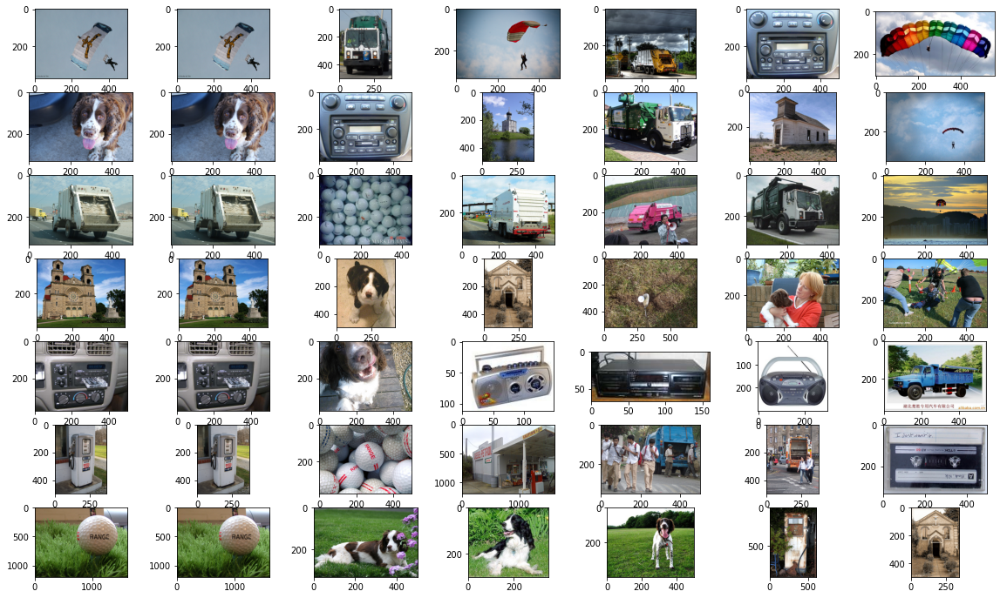

#### alexnet euclidean ####



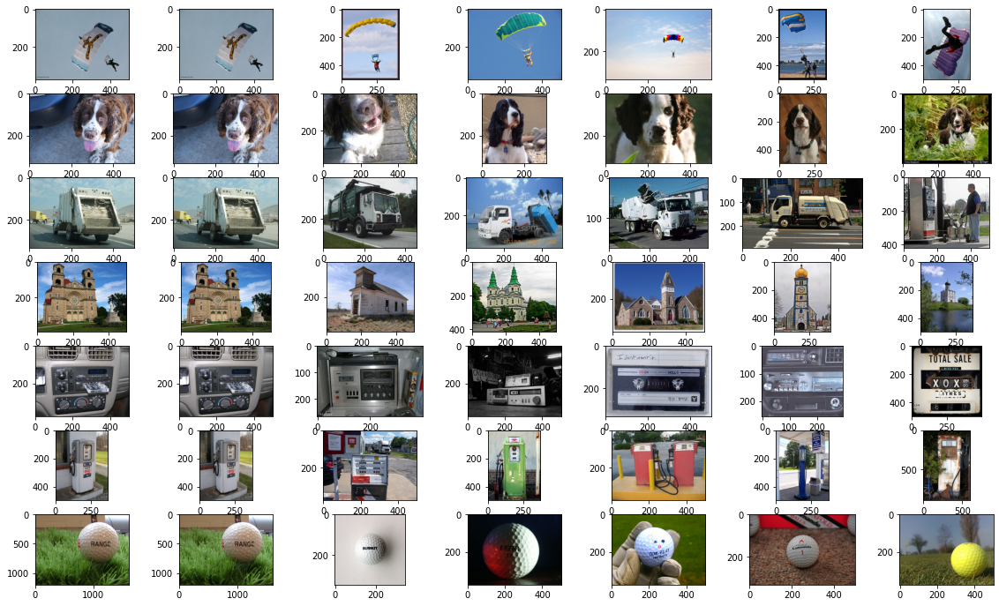

#### alexnet cosine ####



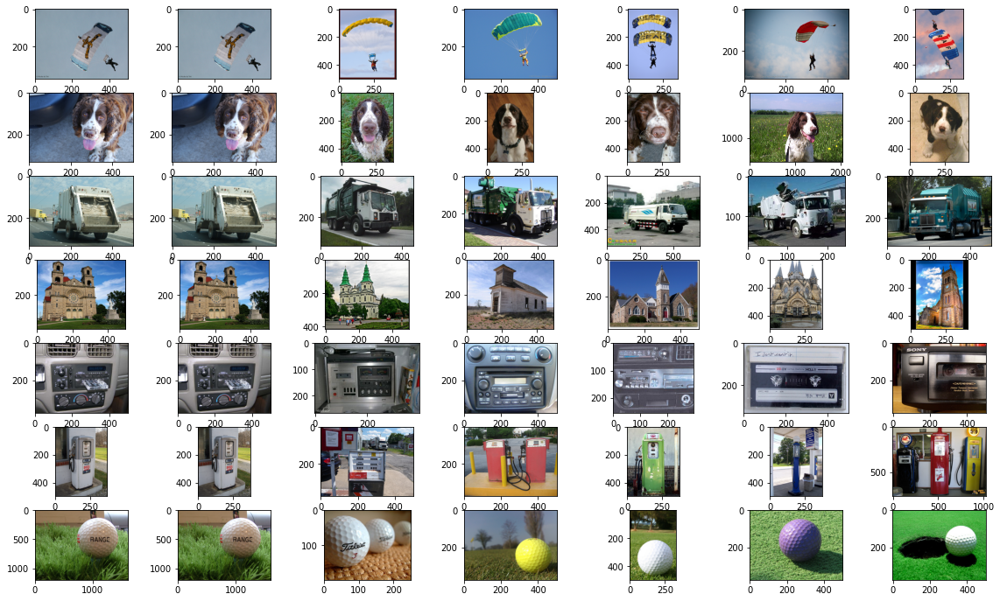

#### densenet euclidean ####



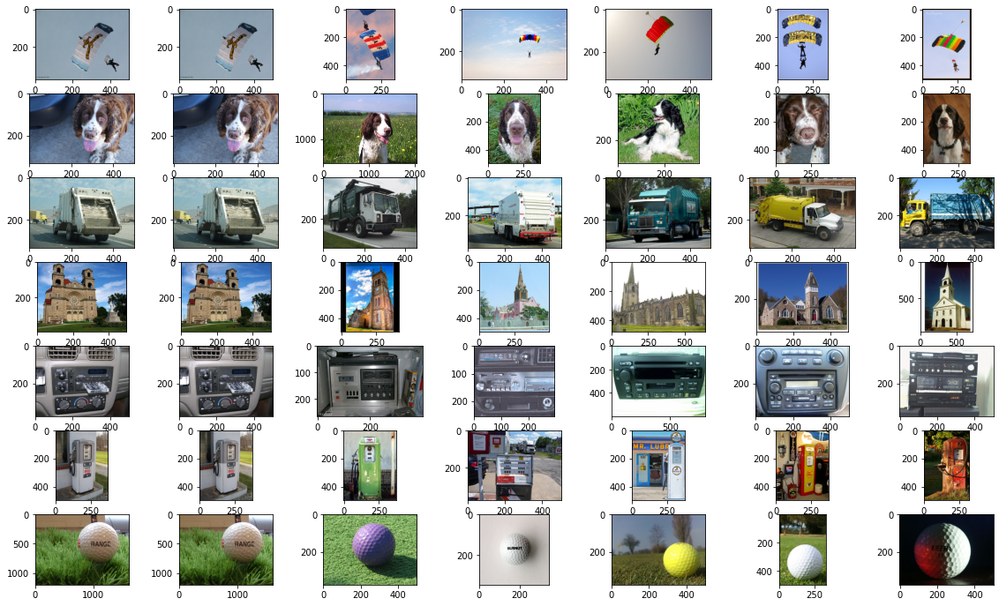

#### densenet cosine ####



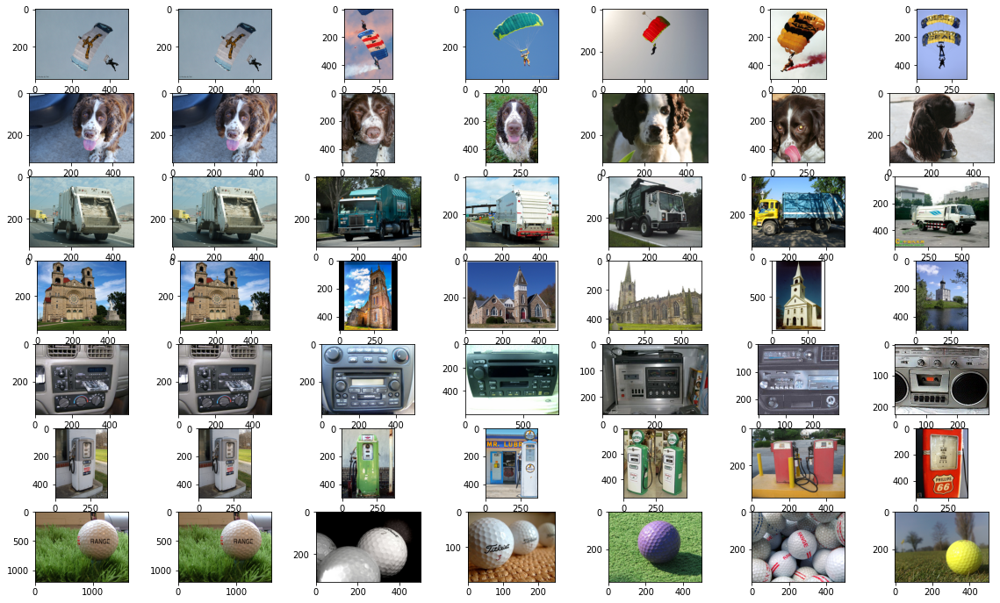

#### grey_hist euclidean ####



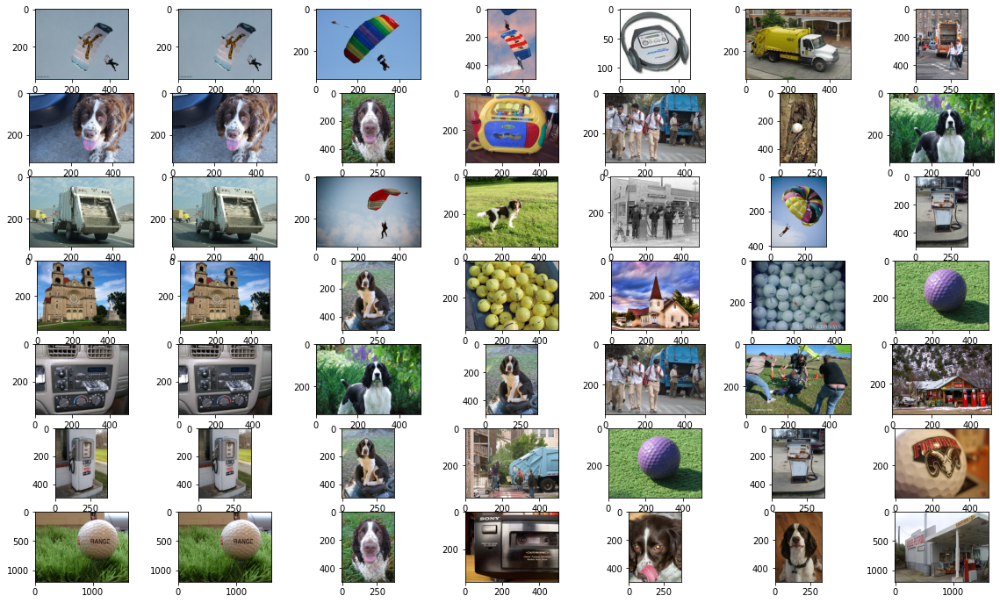

#### grey_hist cosine ####



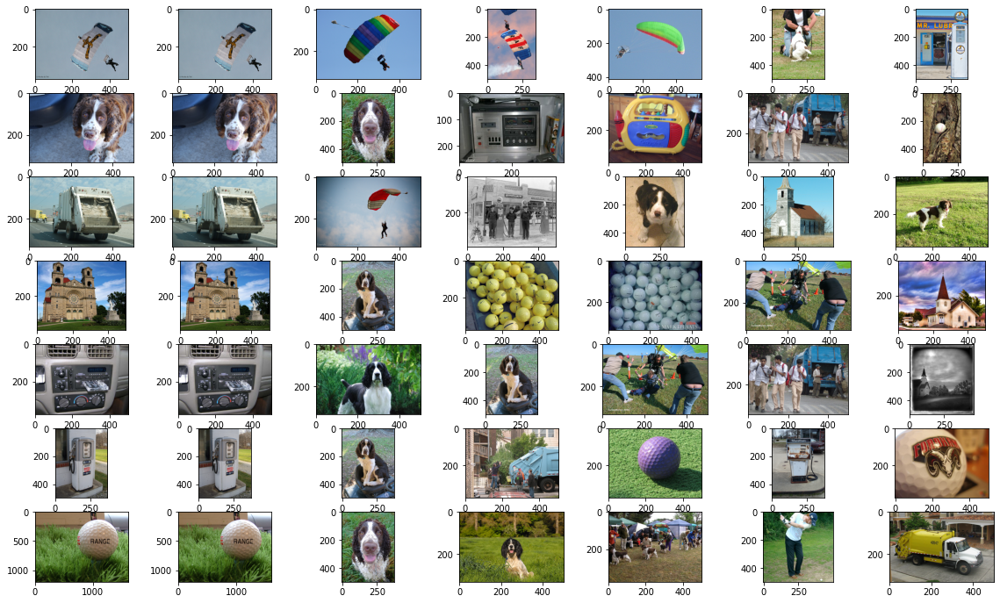

#### resnet-18 euclidean ####



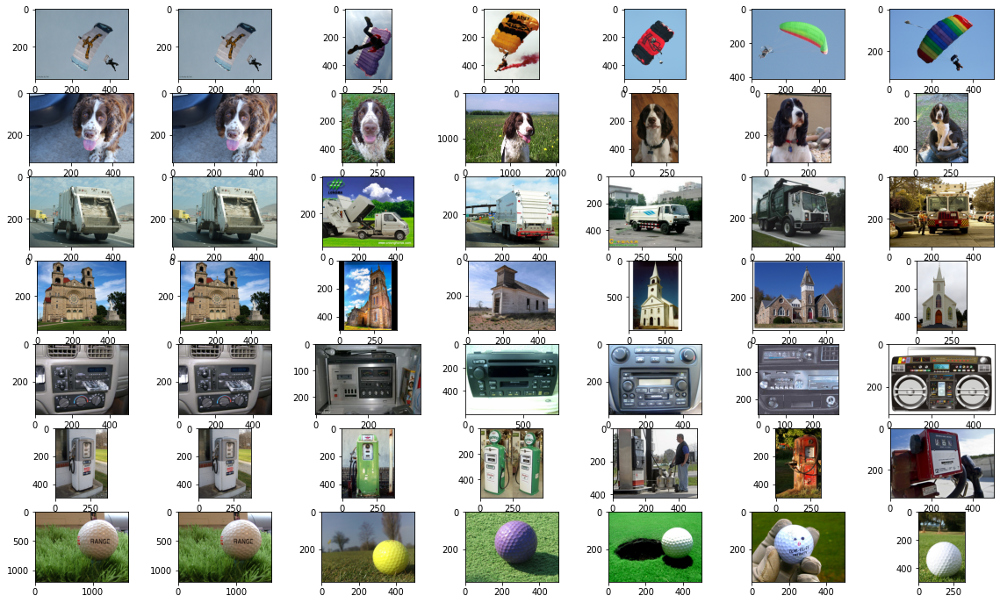

#### resnet-18 cosine ####



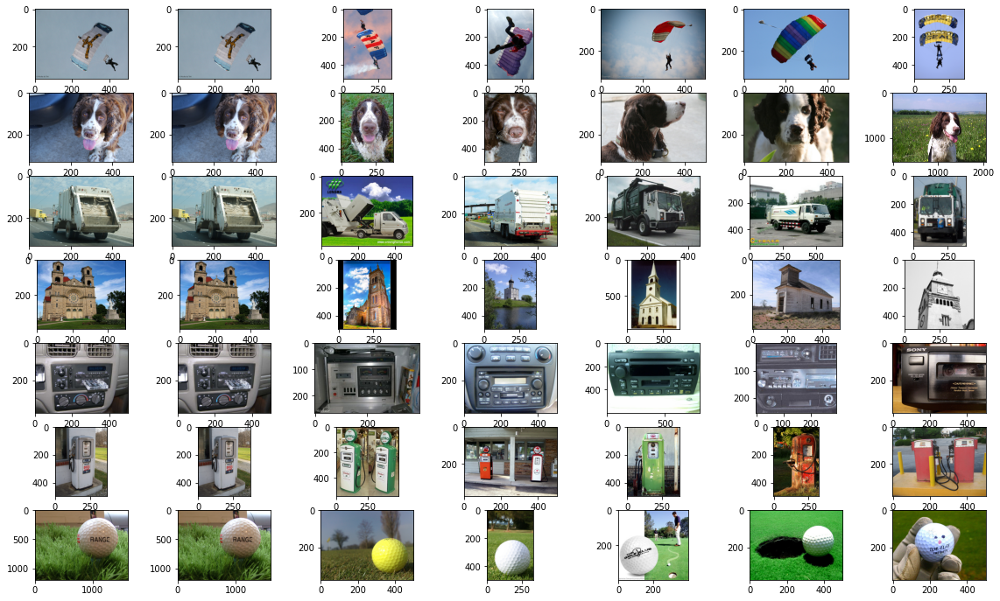

#### resnet50 euclidean ####



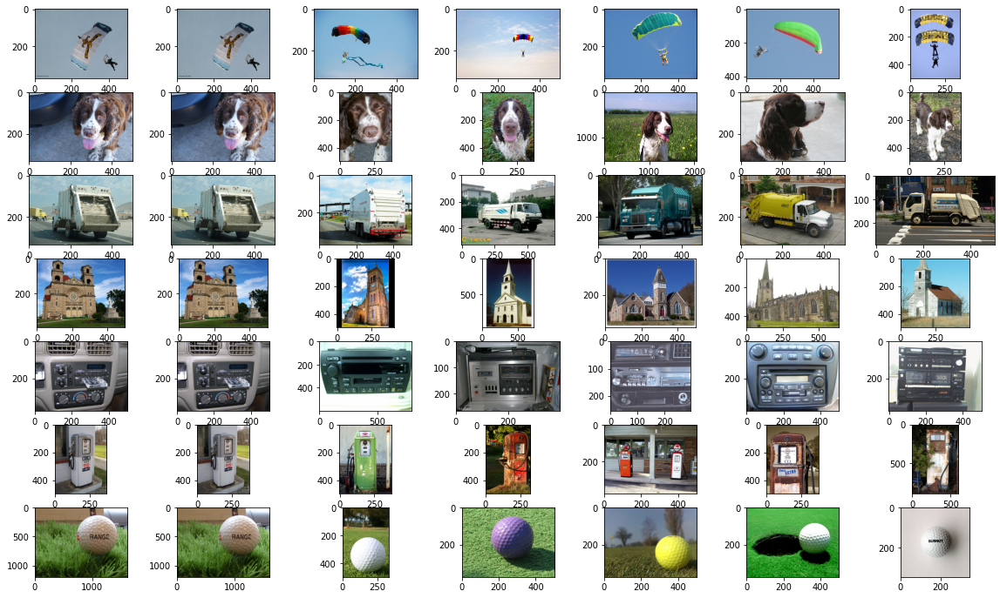

#### resnet50 cosine ####



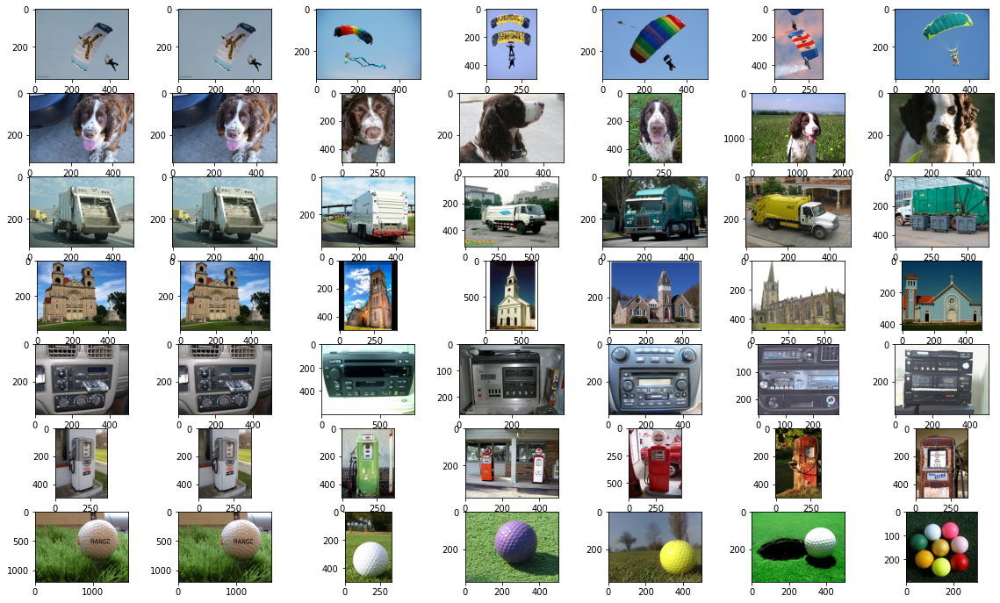

#### vgg euclidean ####



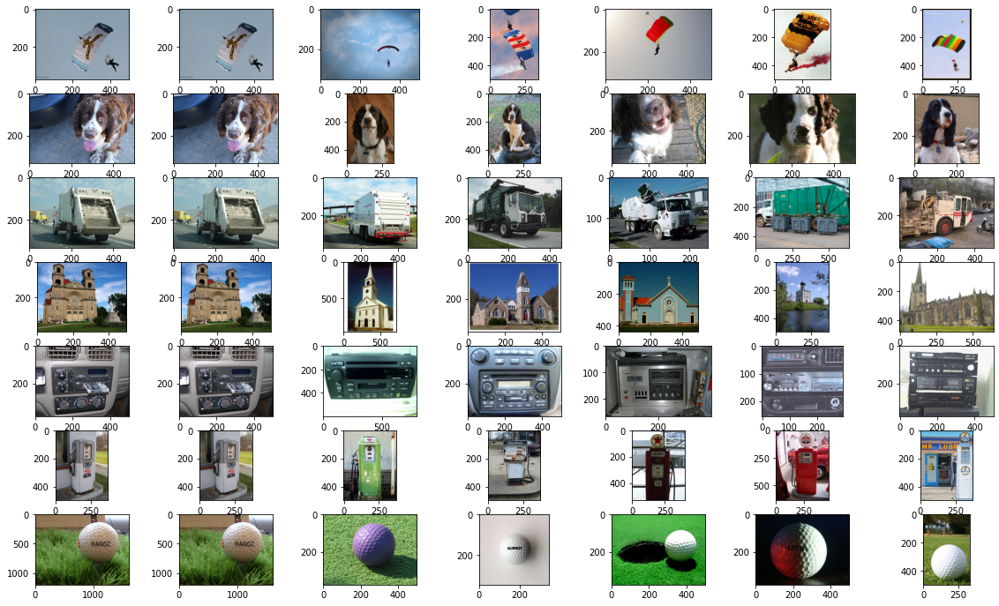

#### vgg cosine ####



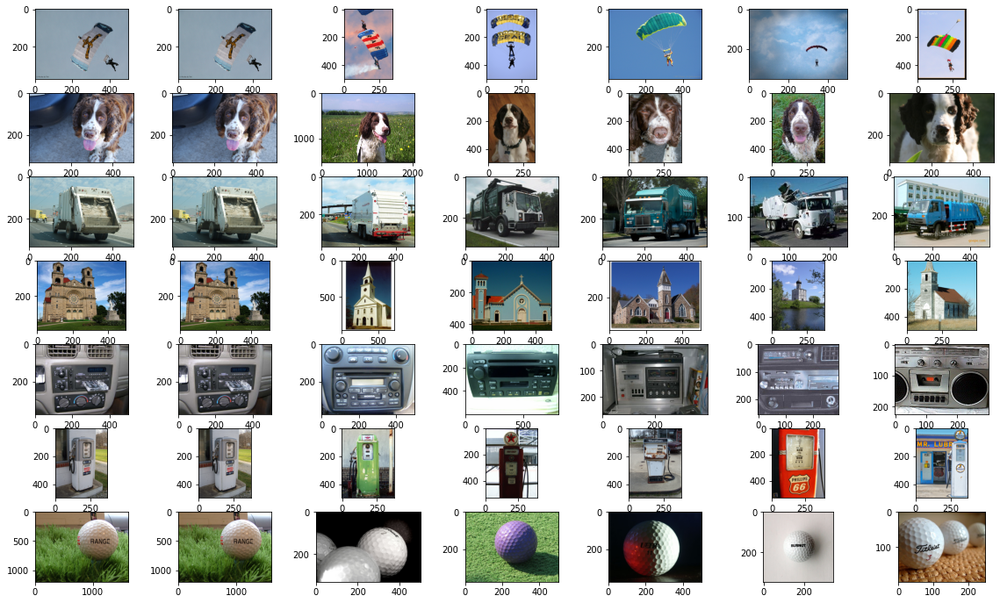

In [37]:
for model in ["color_hist", "alexnet", "densenet", "grey_hist", "resnet-18", "resnet50", "vgg"]:
  features_file = "features_"+model+".hdf5"
  hf = h5py.File(os.path.join(path, features_file), 'r')
  images = hf["images"][:]
  images = [x.decode("UTF-8") for x in images]
  for metric in ["euclidean", "cosine"]:
    print("####", model, metric, "####")
    print("")
    if os.path.exists(os.path.join(path, "kernel_"+metric+"_"+model+".hdf5")):
        # print("Kernel already exists for ", model, metric, " loading it.")
        with h5py.File(os.path.join(path, "kernel_"+metric+"_"+model+".hdf5")) as f:
            kernel = f["kernel"][:]
        # print("Shape of loaded kernel = ", kernel.shape)
    else:
        raise Exception("Pre-computed kernel doesn't exist")
    
    plt.figure(figsize = (20, 12))
    plotRowIndex = 0
    for query in queries:
        plt.subplot(7, 7, (plotRowIndex*7+1))
        image_path = os.path.join(path, query)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
        plt.imshow(img)
        # print("Query = ", query)
        queryIndex = images.index(query)
        # print("Query index = ", queryIndex)
        kernelRow = kernel[queryIndex]
        #kernelRowNP = np.array(kernelRow)
        top6Indices = kernelRow.argsort()[-6:][::-1]
        top6Images = [images[x] for x in top6Indices]
        imageIndex = 0
        for result in top6Images:
            plt.subplot(7, 7, plotRowIndex*7+1+imageIndex+1)
            image_path = os.path.join(path, result)
            img = cv2.imread(image_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
            plt.imshow(img)
            imageIndex += 1
        plotRowIndex += 1
    plt.show()
  hf.close()

# t-SNE Visualization using VGG Features

In [25]:
from PIL import Image
import h5py
import os

classes = {"truck":0, "parachute":1, "golf":2, "gas":3, "dog":4, "church":5, "cassette":6}

def extractFeaturesWithLabels(path, method):
  hdf5_path = os.path.join(path, 'features_labels_'+method+'.hdf5')
  f = h5py.File(hdf5_path, mode='w')
  if method.startswith('resnet') or method == 'alexnet' or method == 'vgg' or method == 'densenet':
    img2vec = Img2Vec(cuda=False, model=method)
    imgs = []
    image_list = []
    labels = []
    for cls in classes:
      images = os.listdir(os.path.join(path,cls))
      for image in images:
        if image.endswith('hdf5') or os.path.isdir(os.path.join(path, image)):
          continue
        image_path = os.path.join(path, cls, image)
        img = Image.open(image_path).convert('RGB')
        imgs.append(img)
        image_list.append(image)
        labels.append(classes[cls])
    vectors = img2vec.get_vec(imgs)
    print("Features from ", method, vectors.shape)
    f.create_dataset("features", data=vectors)
    f.create_dataset("images", data=image_list)
    f.create_dataset("labels", data=labels)
    f.close()

In [ ]:
path = '/content/drive/MyDrive/demo-image-collection-labeled'
extractFeaturesWithLabels(path, "vgg")

Using:  vgg  for feature extraction.


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Features from  vgg (280, 4096)


Features:  (280, 4096)
Images:  (280,)
Labels:  (280,)


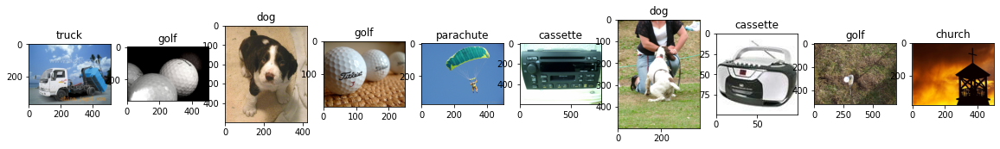

In [65]:
import matplotlib.pyplot as plt
import random
import h5py
import os
from PIL import Image

path = '/content/drive/MyDrive/demo-image-collection-labeled'
classes_id = {0:"truck", 1:"parachute", 2:"golf", 3:"gas", 4:"dog", 5:"church", 6:"cassette"}
hf = h5py.File(os.path.join(path, "features_labels_vgg.hdf5"), 'r')
features = hf["features"][:]
print("Features: ", features.shape)
images = hf["images"][:]
print("Images: ", images.shape)
images = [x.decode("UTF-8") for x in images]
labels = hf["labels"][:]
print("Labels: ", labels.shape)
index = 1
plt.figure(figsize=(20,4))
ids = random.sample(range(280), 10)
for i in ids:
  image_path = os.path.join(path, classes_id[labels[i]], images[i])
  img = Image.open(image_path).convert('RGB')
  plt.subplot(1,10,index)
  plt.title(classes_id[labels[i]])
  plt.imshow(img)
  index+=1

In [27]:
import sklearn
sklearn.__version__

'0.24.2'

In [ ]:
!pip uninstall scikit-learn -y

Found existing installation: scikit-learn 0.22.2.post1
Uninstalling scikit-learn-0.22.2.post1:
  Successfully uninstalled scikit-learn-0.22.2.post1


In [ ]:
!pip install -U scikit-learn

     |████████████████████████████████| 22.3 MB 1.3 MB/s 


Ground data:  (280, 4096)
Ground images:  (280,)
Using:  vgg  for feature extraction.
Query data:  (2, 4096)


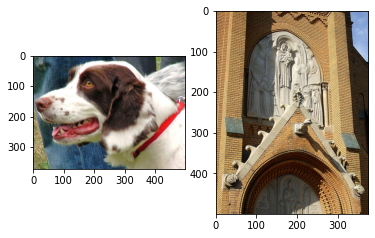

In [66]:
features_file = "features_labels_vgg.hdf5"
hf = h5py.File(os.path.join(path, features_file), 'r')
ground_data = hf["features"][:]
print("Ground data: ", ground_data.shape)
ground_images = hf["images"][:]
print("Ground images: ", ground_images.shape)
ground_images = [x.decode("UTF-8") for x in ground_images]
ground_labels = hf["labels"][:]
new_queries = ["dog", "church"]
img2vec = Img2Vec(cuda=False, model="vgg")
query_images = []
index = 1
for query in new_queries:
    image_path = os.path.join(path, "queries", query+".JPEG")
    img = Image.open(image_path).convert('RGB')
    plt.subplot(1,len(new_queries),index)
    plt.imshow(img)
    query_images.append(img)
    index+=1
query_data = img2vec.get_vec(query_images)
print("Query data: ", query_data.shape)

In [67]:
from submodlib.helper import create_kernel
image_image_kernel = create_kernel(ground_data, "cosine")
print("Image-image kernel: ", image_image_kernel.shape)
image_query_kernel = create_kernel(X=query_data, metric="cosine", mode="dense", X_rep=ground_data)
print("Image-query kernel: ", image_query_kernel.shape)
query_query_kernel = create_kernel(query_data, "cosine")
print("Query-query kernel: ", query_query_kernel.shape)

Image-image kernel:  (280, 280)
Image-query kernel:  (280, 2)
Query-query kernel:  (2, 2)


In [72]:
from sklearn.manifold import TSNE
features_tsne = np.concatenate((features, query_data), axis=0)
labels_tsne = np.concatenate([labels, [7,7]])
tsne = TSNE(n_components=2).fit_transform(features_tsne)

In [73]:
import numpy as np
# scale and move the coordinates so they fit [0; 1] range

def scale_to_05_range(x):
    # compute the distribution range
    value_range = (np.max(x) - np.min(x))
    # move the distribution so that it starts from zero
    # by extracting the minimal value from all its values
    starts_from_zero = x - np.min(x)
    # make the distribution fit [0; 1] by dividing by its range
    return (starts_from_zero / value_range)*5.

# extract x and y coordinates representing the positions of the images on T-SNE plot
tx = tsne[:, 0]
ty = tsne[:, 1]
tx = scale_to_05_range(tx)
ty = scale_to_05_range(ty)

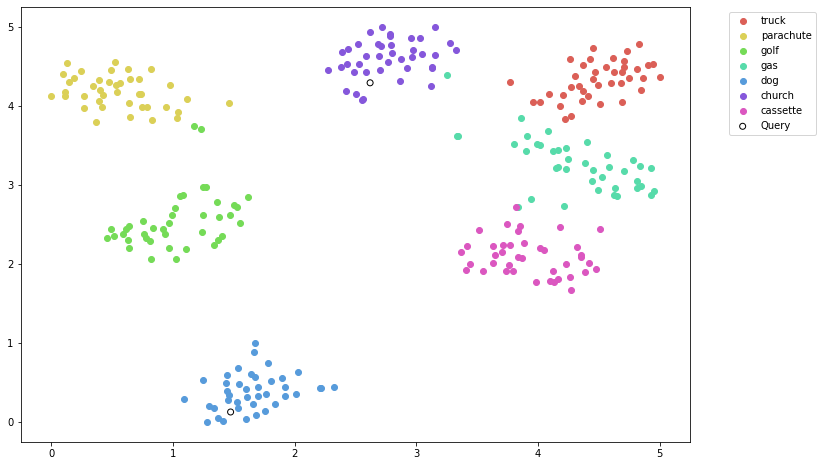

In [75]:
import seaborn as sns

# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()

# Selection by different functions of submodlib using VGG features with cosine metric

# FL1MI

[(181, 65.1003550440073), (221, 11.048711903393269), (194, 2.388381101191044), (127, 0.9371853247284889), (225, 0.39240509271621704), (186, 0.030810773372650146), (218, 0.02424725890159607), (279, 0.0), (278, 0.0), (277, 0.0), (276, 0.0), (275, 0.0), (274, 0.0), (273, 0.0), (272, 0.0), (271, 0.0), (270, 0.0), (269, 0.0), (268, 0.0), (267, 0.0)]


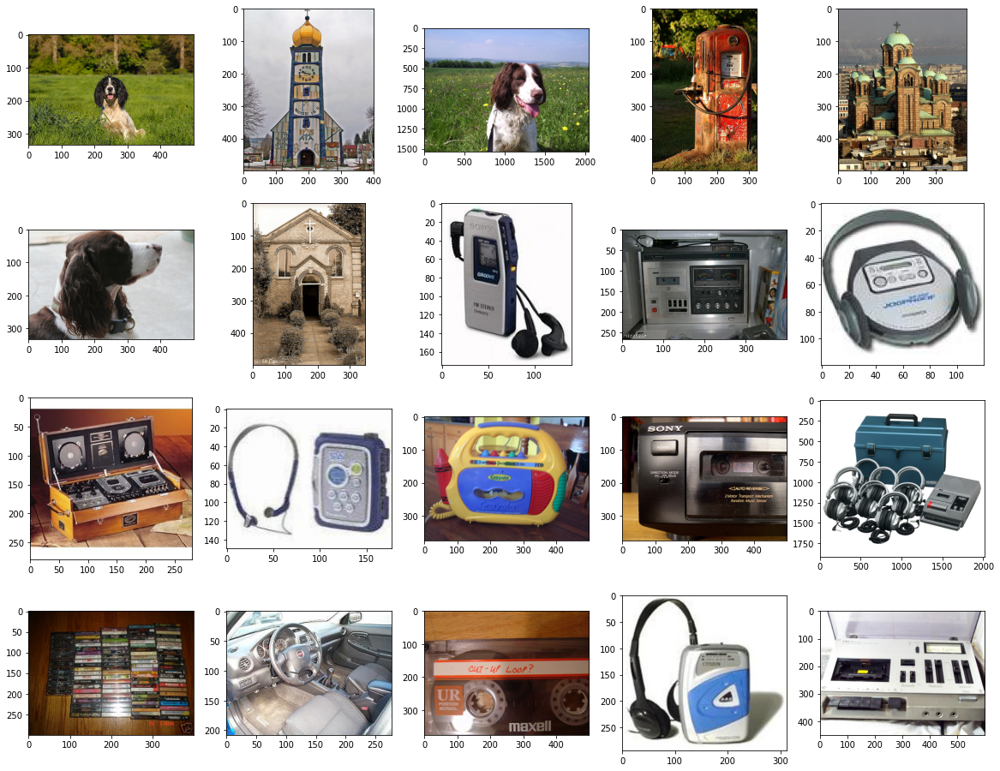

In [77]:
from submodlib import FacilityLocationMutualInformationFunction
obj = FacilityLocationMutualInformationFunction(n=280, num_queries=2, data_sijs=image_image_kernel, 
                                                query_sijs=image_query_kernel, metric="cosine")
greedyList = obj.maximize(budget=20,optimizer='NaiveGreedy', stopIfZeroGain=False, 
                          stopIfNegativeGain=False, verbose=False)
print(greedyList)
row = 0
index = 1
plt.figure(figsize=(20, 16))
for elem in greedyList:
  plt.subplot(4, 5, row*5+index)
  image_path = os.path.join(path, classes_id[labels[elem[0]]], ground_images[elem[0]])
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

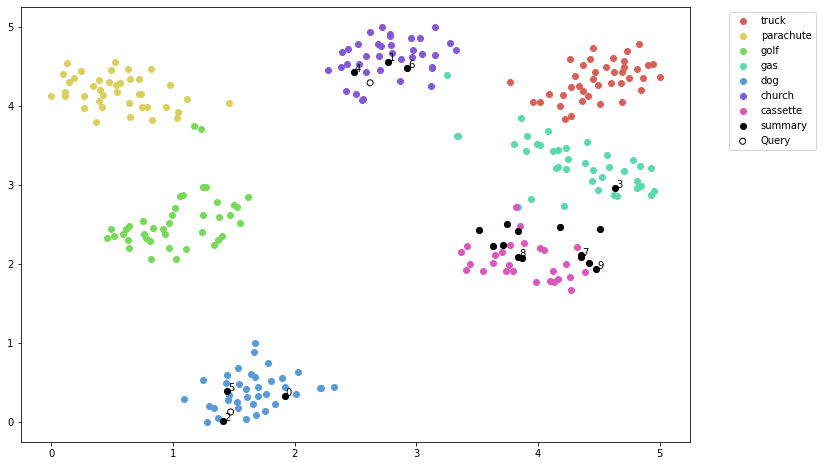

In [78]:
# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

greedyXs = [tx[x[0]] for x in greedyList]
greedyYs = [ty[x[0]] for x in greedyList]
ax.scatter(greedyXs, greedyYs, color='black', label="summary")
for text, element in enumerate(greedyList[:10]):
    ax.annotate(text, (tx[element[0]], ty[element[0]]), (tx[element[0]]+0.01, ty[element[0]]+0.01))
# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()

# FL2MI

[(182, 1.7850237488746643), (209, 1.0783738493919373), (194, 0.8058991432189941), (180, 0.7696292996406555), (176, 0.7486785650253296), (197, 0.7486340999603271), (171, 0.7479632496833801), (160, 0.745407223701477), (169, 0.7191559672355652), (192, 0.7125688195228577), (166, 0.7045035362243652), (165, 0.6984765529632568), (196, 0.6900450587272644), (161, 0.6804708242416382), (186, 0.677311360836029), (195, 0.676482081413269), (174, 0.6757397651672363), (199, 0.6368451714515686), (183, 0.605404794216156), (177, 0.6046162247657776)]


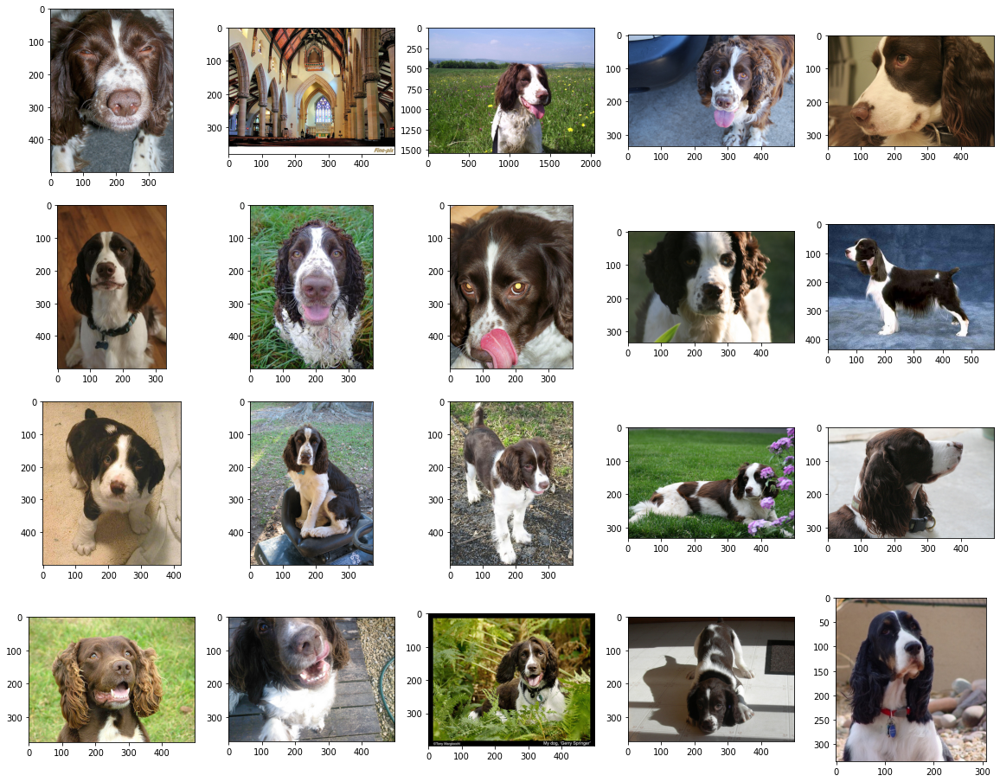

In [79]:
from submodlib import FacilityLocationVariantMutualInformationFunction
obj = FacilityLocationVariantMutualInformationFunction(n=280, num_queries=2, 
                                                       query_sijs=image_query_kernel, 
                                                       metric="cosine")
greedyList = obj.maximize(budget=20,optimizer='NaiveGreedy', stopIfZeroGain=False, 
                          stopIfNegativeGain=False, verbose=False)
print(greedyList)
row = 0
index = 1
plt.figure(figsize=(20, 16))
for elem in greedyList:
  plt.subplot(4, 5, row*5+index)
  image_path = os.path.join(path, classes_id[labels[elem[0]]], ground_images[elem[0]])
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

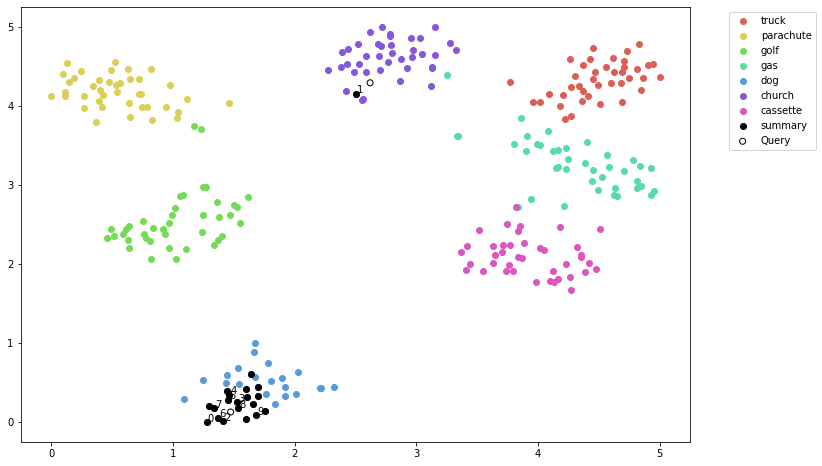

In [80]:
# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

greedyXs = [tx[x[0]] for x in greedyList]
greedyYs = [ty[x[0]] for x in greedyList]
ax.scatter(greedyXs, greedyYs, color='black', label="summary")
for text, element in enumerate(greedyList[:10]):
    ax.annotate(text, (tx[element[0]], ty[element[0]]), (tx[element[0]]+0.01, ty[element[0]]+0.01))
# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()

# COM

[(182, 1.3986210779459074), (180, 1.1258804305722054), (174, 1.013747507461082), (194, 0.949401145088334), (171, 0.8899007870530105), (176, 0.8583838050917656), (209, 0.8289133314790624), (197, 0.8099975878837937), (160, 0.7893940796498371), (166, 0.7658525540296615), (192, 0.7456942173044494), (200, 0.7210526308812586), (165, 0.7135312397917497), (169, 0.7044760052159771), (161, 0.6938365695350748), (183, 0.6854786444222838), (196, 0.6801580856867075), (187, 0.6755187423512945), (199, 0.668323672874104), (195, 0.6603240795966627)]


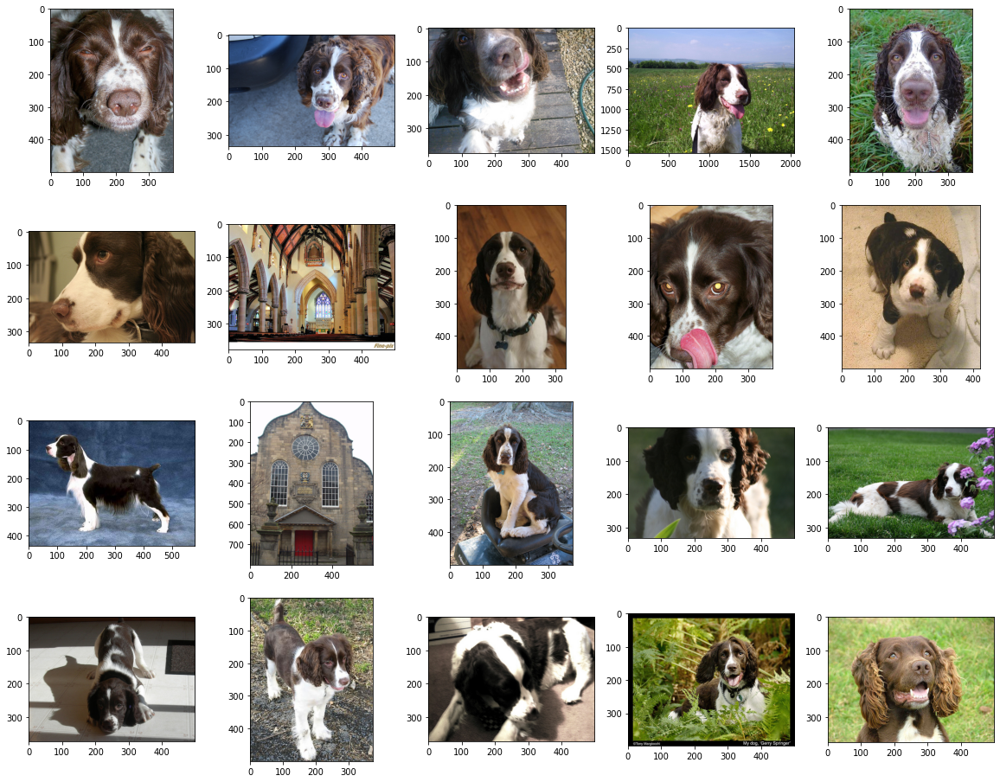

In [81]:
from submodlib import ConcaveOverModularFunction
obj = ConcaveOverModularFunction(n=280, num_queries=2, 
                                                       query_sijs=image_query_kernel, 
                                                       metric="cosine")
greedyList = obj.maximize(budget=20,optimizer='NaiveGreedy', stopIfZeroGain=False, 
                          stopIfNegativeGain=False, verbose=False)
print(greedyList)
row = 0
index = 1
plt.figure(figsize=(20, 16))
for elem in greedyList:
  plt.subplot(4, 5, row*5+index)
  image_path = os.path.join(path, classes_id[labels[elem[0]]], ground_images[elem[0]])
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

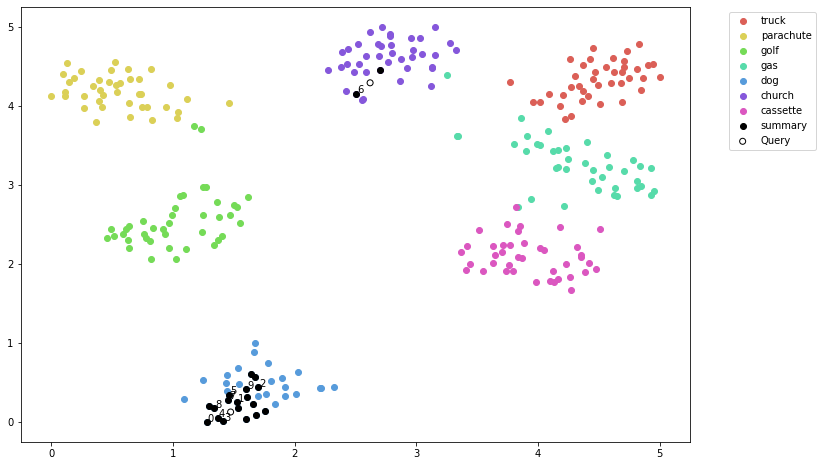

In [82]:
# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

greedyXs = [tx[x[0]] for x in greedyList]
greedyYs = [ty[x[0]] for x in greedyList]
ax.scatter(greedyXs, greedyYs, color='black', label="summary")
for text, element in enumerate(greedyList[:10]):
    ax.annotate(text, (tx[element[0]], ty[element[0]]), (tx[element[0]]+0.01, ty[element[0]]+0.01))
# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()

# GCMI

[(182, 0.9585362076759338), (194, 0.9225877970457077), (180, 0.9178592711687088), (171, 0.8900483399629593), (176, 0.8897608667612076), (197, 0.8837392032146454), (174, 0.8825805634260178), (160, 0.8781542479991913), (166, 0.8562686890363693), (192, 0.8473949581384659), (169, 0.8267599642276764), (165, 0.8256173580884933), (161, 0.8130791485309601), (196, 0.8098020777106285), (195, 0.7959194034337997), (199, 0.7948088496923447), (183, 0.7944638580083847), (187, 0.7888554483652115), (186, 0.7828819677233696), (175, 0.7479244768619537)]


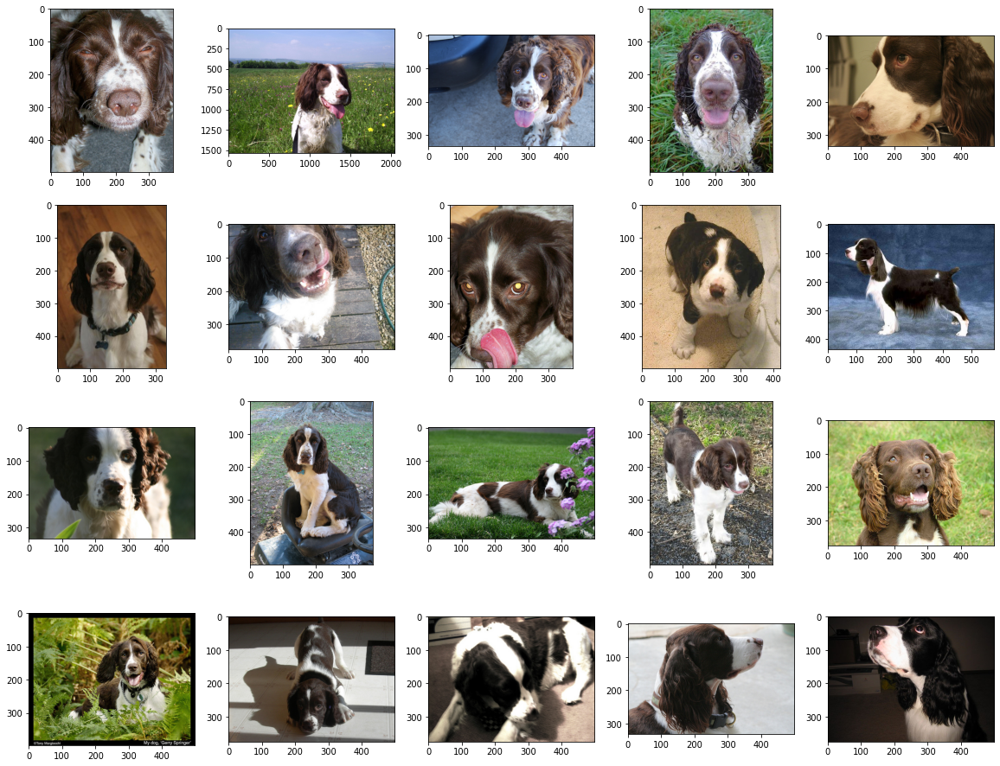

In [83]:
from submodlib import GraphCutMutualInformationFunction
obj = GraphCutMutualInformationFunction(n=280, num_queries=2, 
                                                       query_sijs=image_query_kernel, 
                                                       metric="cosine")
greedyList = obj.maximize(budget=20,optimizer='NaiveGreedy', stopIfZeroGain=False, 
                          stopIfNegativeGain=False, verbose=False)
print(greedyList)
row = 0
index = 1
plt.figure(figsize=(20, 16))
for elem in greedyList:
  plt.subplot(4, 5, row*5+index)
  image_path = os.path.join(path, classes_id[labels[elem[0]]], ground_images[elem[0]])
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

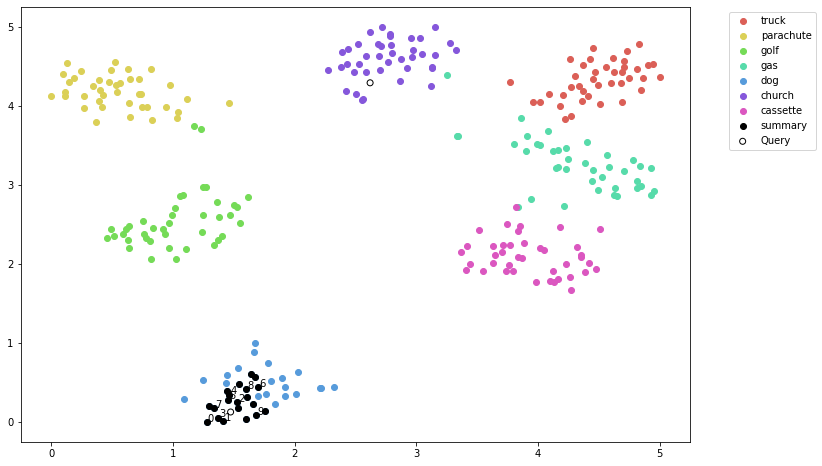

In [84]:
# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

greedyXs = [tx[x[0]] for x in greedyList]
greedyYs = [ty[x[0]] for x in greedyList]
ax.scatter(greedyXs, greedyYs, color='black', label="summary")
for text, element in enumerate(greedyList[:10]):
    ax.annotate(text, (tx[element[0]], ty[element[0]]), (tx[element[0]]+0.01, ty[element[0]]+0.01))
# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()

# LogDetMI

[(182, 0.18940375734684967), (209, 0.09493332124984732), (194, 0.07840888245158195), (200, 0.04881057079720741), (180, 0.04331406121575404), (176, 0.03032850686888705), (227, 0.027489195895153307), (192, 0.021657027917325156), (229, 0.02136644295033019), (129, 0.016001378859019755), (216, 0.014887597782561268), (166, 0.014562222554454662), (212, 0.009834267649655504), (160, 0.009634929732196151), (242, 0.00933547714037064), (169, 0.007327510025460171), (211, 0.005939017686235171), (165, 0.005641309386466564), (202, 0.005500564734373714), (174, 0.004503603094061004)]


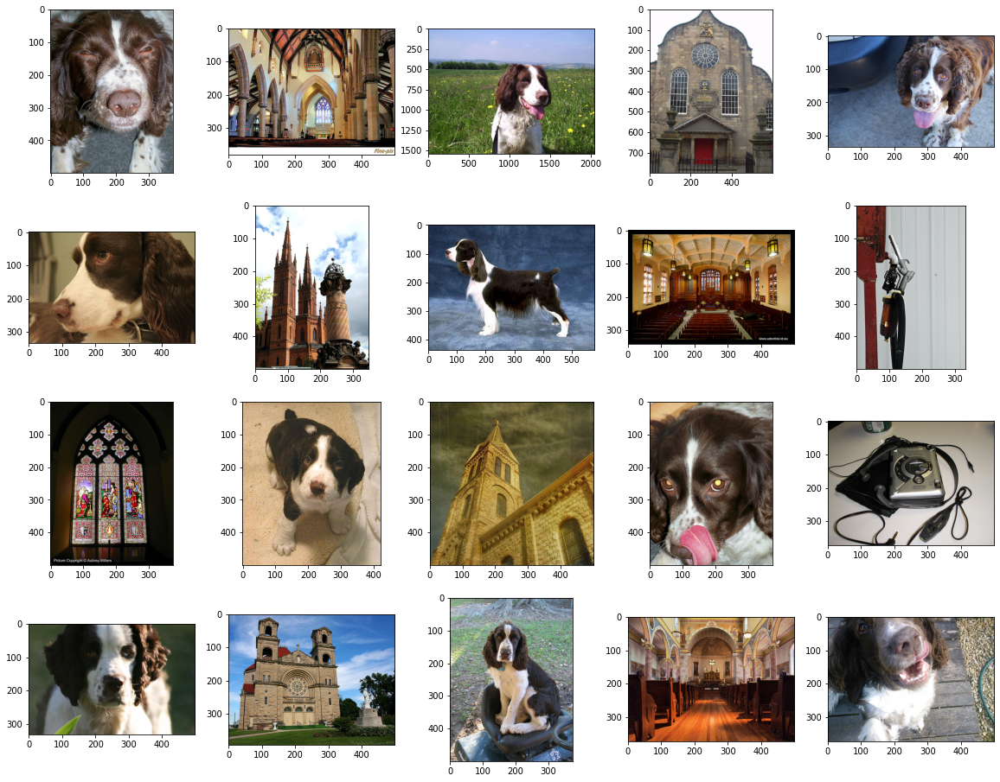

In [85]:
from submodlib import LogDeterminantMutualInformationFunction
obj = LogDeterminantMutualInformationFunction(n=280, num_queries=2, data_sijs=image_image_kernel,
                                                       query_sijs=image_query_kernel, 
                                              query_query_sijs=query_query_kernel,
                                                       metric="cosine", lambdaVal=1)
greedyList = obj.maximize(budget=20,optimizer='NaiveGreedy', stopIfZeroGain=False, 
                          stopIfNegativeGain=False, verbose=False)
print(greedyList)
row = 0
index = 1
plt.figure(figsize=(20, 16))
for elem in greedyList:
  plt.subplot(4, 5, row*5+index)
  image_path = os.path.join(path, classes_id[labels[elem[0]]], ground_images[elem[0]])
  img = cv2.imread(image_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # cv2 load images as BGR, convert it to RGB
  plt.imshow(img)
  index += 1
  if index == 6:
    row += 1
    index = 1

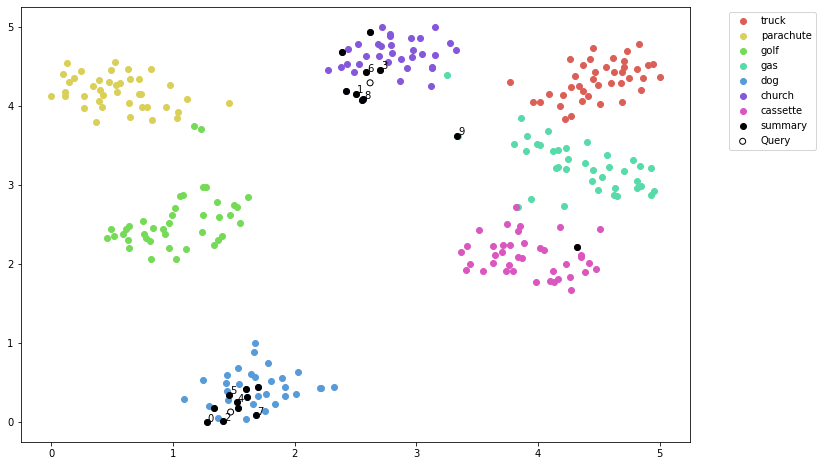

In [86]:
# initialize a matplotlib plot
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
palette = np.array(sns.color_palette("hls", 7))

# for every class, we'll add a scatter plot separately
for label in range(7):
    # find the samples of the current class in the data
    indices = [i for i, l in enumerate(labels) if l == label]

    # extract the coordinates of the points of this class only
    current_tx = np.take(tx, indices)
    current_ty = np.take(ty, indices)

    # add a scatter plot with the corresponding color and label
    ax.scatter(current_tx, current_ty, c=palette[label].reshape(1, 3), label=classes_id[label])

greedyXs = [tx[x[0]] for x in greedyList]
greedyYs = [ty[x[0]] for x in greedyList]
ax.scatter(greedyXs, greedyYs, color='black', label="summary")
for text, element in enumerate(greedyList[:10]):
    ax.annotate(text, (tx[element[0]], ty[element[0]]), (tx[element[0]]+0.01, ty[element[0]]+0.01))
# show query points
indices = [i for i, l in enumerate(labels_tsne) if l == 7]
current_tx = np.take(tx, indices)
current_ty = np.take(ty, indices)
ax.scatter(current_tx, current_ty, facecolors='none', edgecolors='black', label="Query")
# build a legend using the labels we set previously
# ax.legend(loc='best')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# finally, show the plot
plt.show()